In [ ]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 660.5/660.5 kB 6.7 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import os
from IPython.display import display, Image
from IPython import display
display.clear_output()
!yolo checks

In [3]:
!pip install roboflow
from roboflow import Roboflow
rf = Roboflow(api_key="dr3rBx7YK4RuFkHAV7cy")
project = rf.workspace("emmanuel-ozoagu-uj17r").project("car-logo-detector")
dataset = project.version(2).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to car-logo-detector-2 in yolov5pytorch:: 100%|██████████| 4040/4040 [00:00<00:00, 4716.51it/s]


In [4]:
!yolo task=detect mode=train model=yolov8m.pt data={dataset.location}/data.yaml epochs=12 imgsz=640

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/car-logo-detector-2/data.yaml, epochs=12, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, 

In [6]:
!yolo task=detect mode=val model=/content/runs/detect/train2/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25850761 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/car-logo-detector-2/valid/labels.cache... 403 images, 0 backgrounds, 0 corrupt: 100% 403/403 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 26/26 [00:13<00:00,  1.87it/s]
                   all        403        431       0.93      0.884      0.926      0.839
                  Opel        403         16          1      0.793      0.882      0.727
               Hyunday        403         51          1      0.974      0.995      0.955
                  Ford        403          5      0.818        0.8       0.92      0.849
                 Honda        403          9      0.957      0.889       0.89      0.878
                   KIA        403          9      0.864      0.712      0.727      0.577
            Mitsubishi        403     

In [7]:
!yolo task=detect mode=predict model=/content/runs/detect/train2/weights/best.pt conf=0.5 source={dataset.location}/test/images

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25850761 parameters, 0 gradients, 78.7 GFLOPs

image 1/198 /content/car-logo-detector-2/test/images/00000aaa1_jpg.rf.4ec460ea54dfab359951e8c91f7fe007.jpg: 640x640 1 Opel, 37.1ms
image 2/198 /content/car-logo-detector-2/test/images/09-opel-mokka-e-512174_16_9_1594452806-880x495_jpg.rf.6b59ca1d398c57cb3a1348c8963c7330.jpg: 640x640 1 Opel, 37.2ms
image 3/198 /content/car-logo-detector-2/test/images/0UAAAgMJpeA-960_jpg.rf.8729ebef9bd2f23b692d6553b04c2d96.jpg: 640x640 1 Opel, 37.1ms
image 4/198 /content/car-logo-detector-2/test/images/11579948_opel-zapchasti-corsa-c-emblema-znak-logotip-bampera_jpg.rf.fee014117fd31f4e63a8e75351d96480.jpg: 640x640 1 Opel, 37.1ms
image 5/198 /content/car-logo-detector-2/test/images/1_org_zoom-2-_jpg.rf.3ca748540ffe089eec7b6311eb5df850.jpg: 640x640 1 Mercedes-Benz, 29.6ms
image 6/198 /content/car-logo-detector-2/test/images/2b0531468b_jpg.

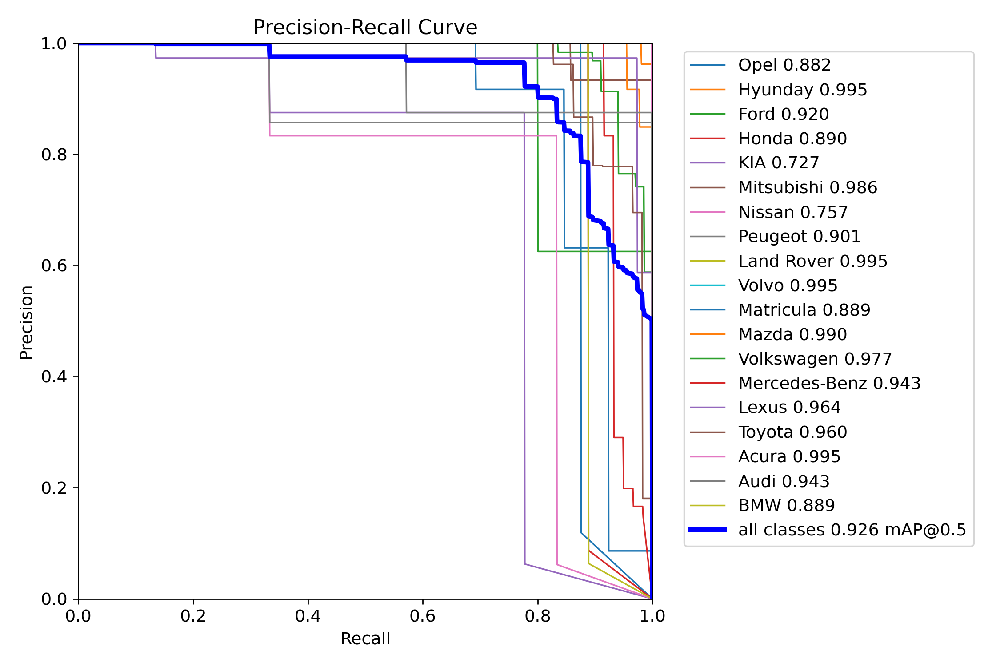

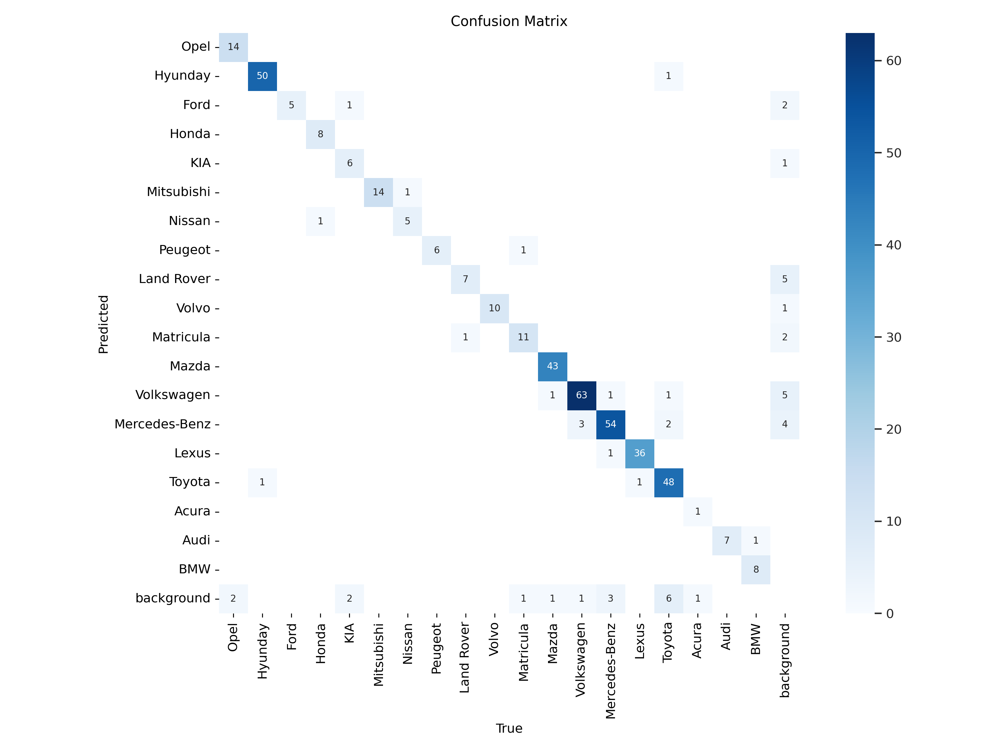

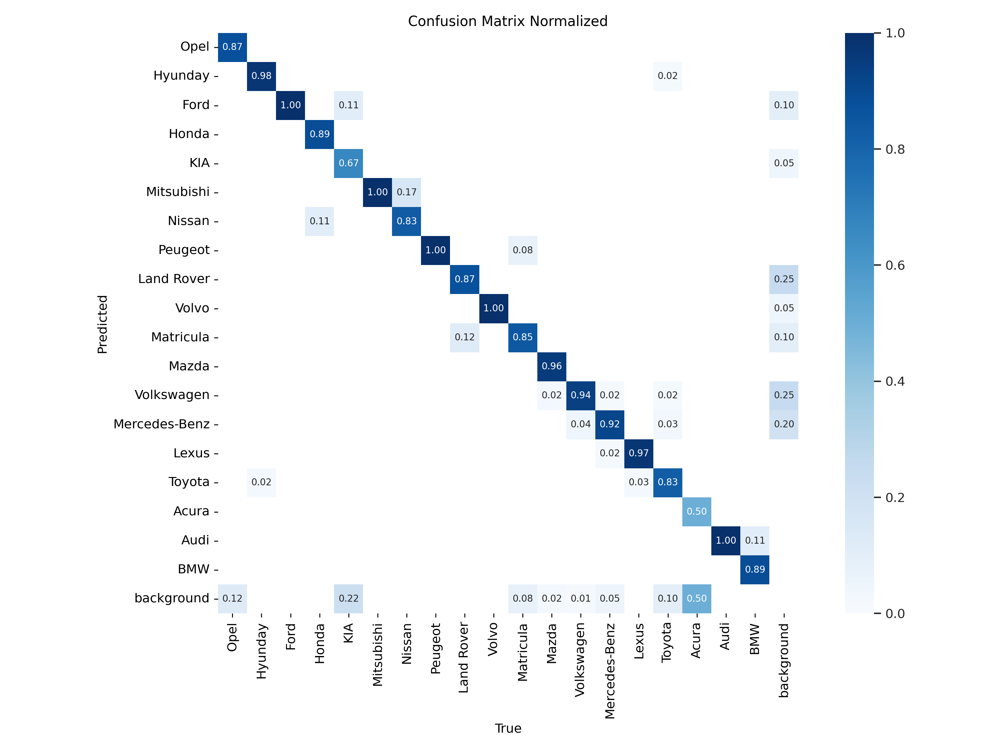

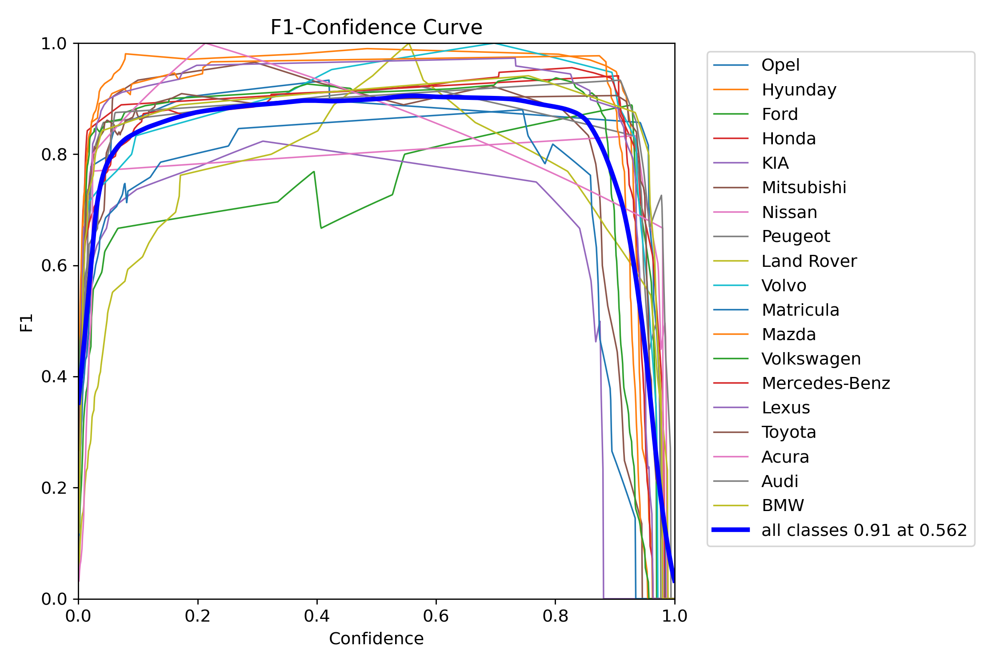

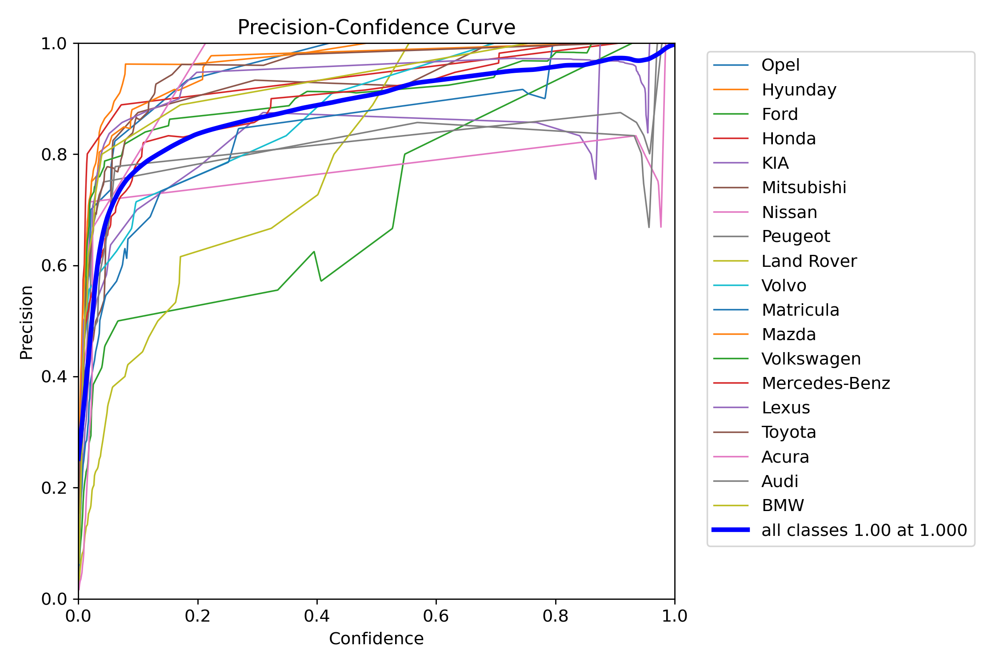

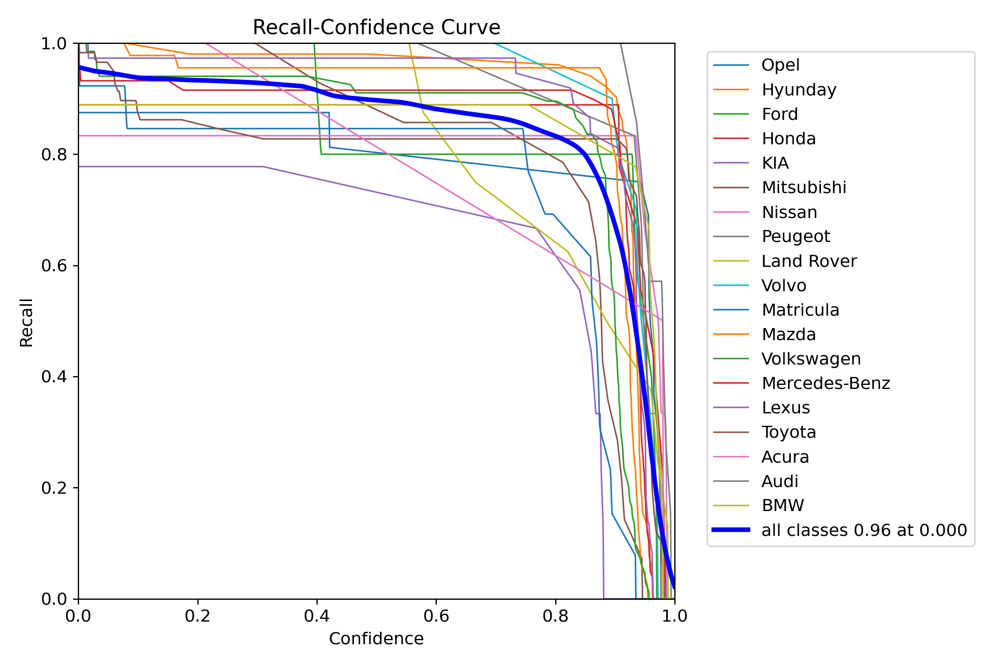

In [8]:
import os
from PIL import Image
from IPython.display import display

# Ruta de la carpeta que contiene los archivos PNG y JPG
folder_path = '/content/runs/detect/val'  # Reemplaza con la ruta de tu carpeta

# Recorre todos los archivos en la carpeta
for file_name in os.listdir(folder_path):
    if file_name.lower().endswith(('.png')):  # Verifica la extensión del archivo
        file_path = os.path.join(folder_path, file_name)  # Ruta completa del archivo
        try:
            img = Image.open(file_path)  # Abre la imagen
            display(img)  # Muestra la imagen en la notebook
        except Exception as e:
            print(f"No se pudo abrir {file_name}: {e}")

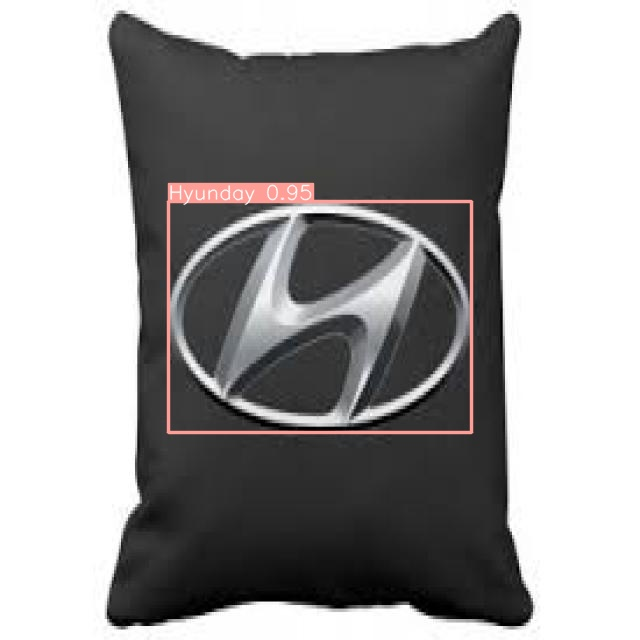

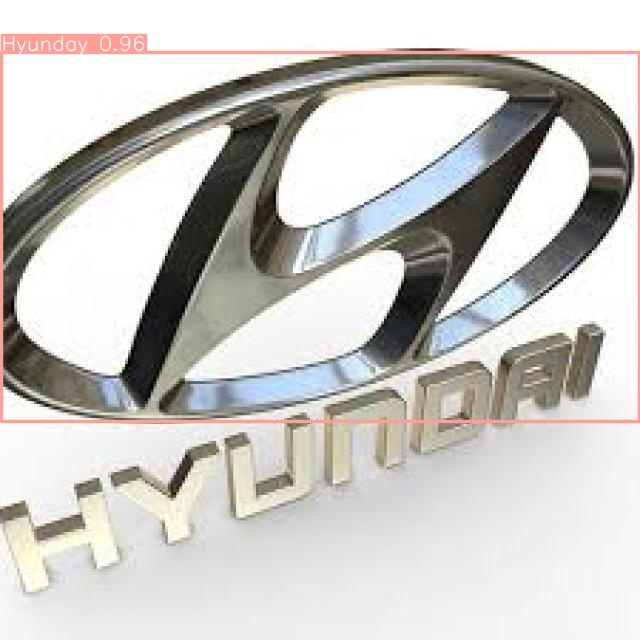

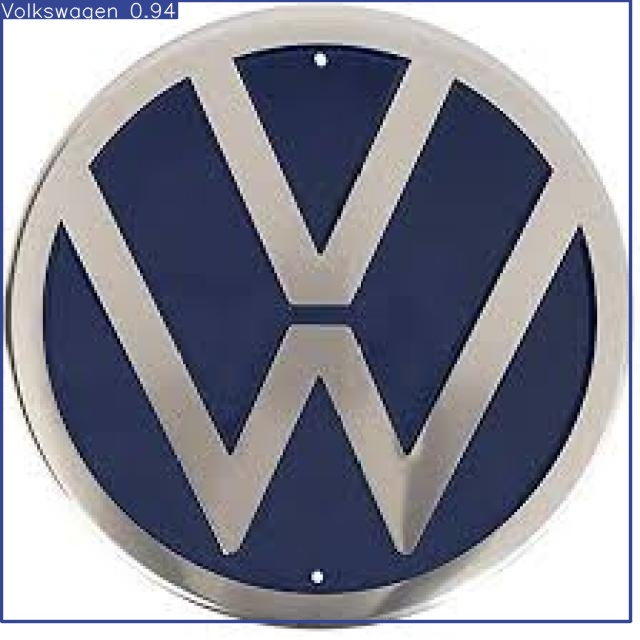

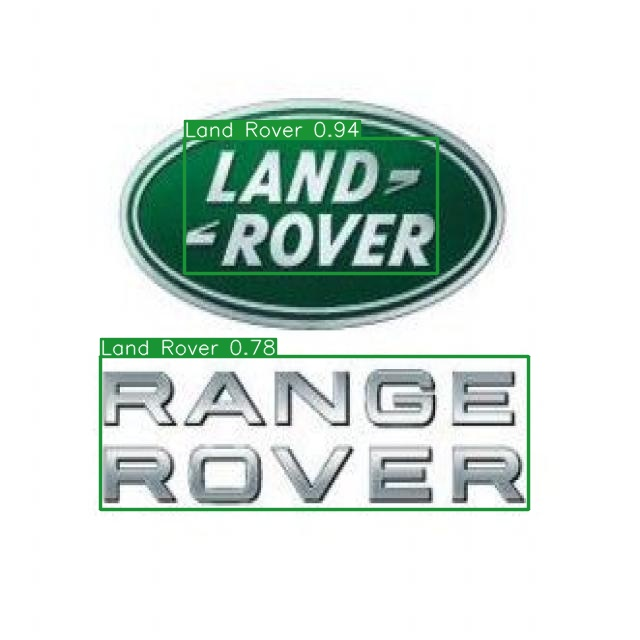

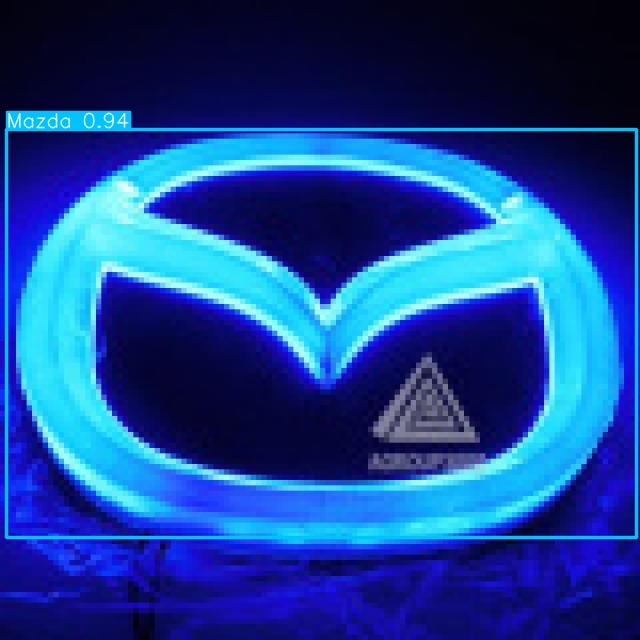

...

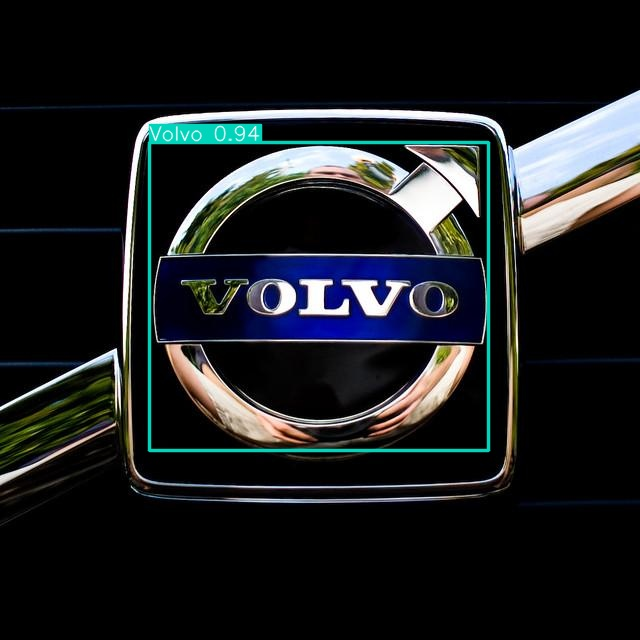

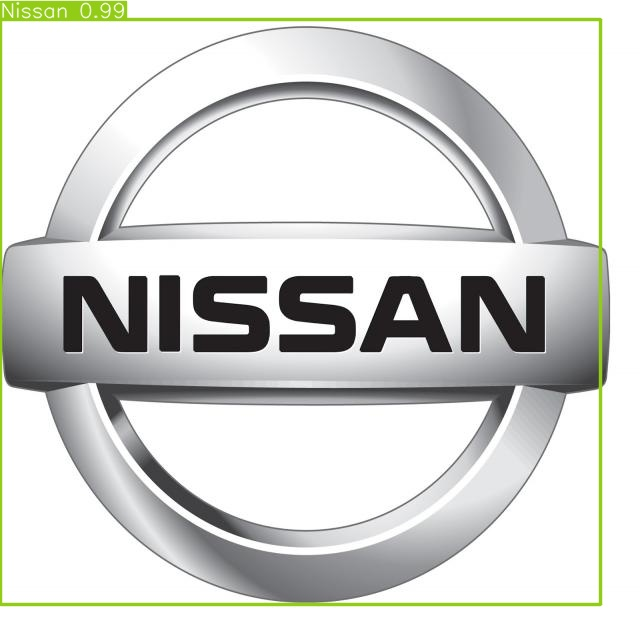

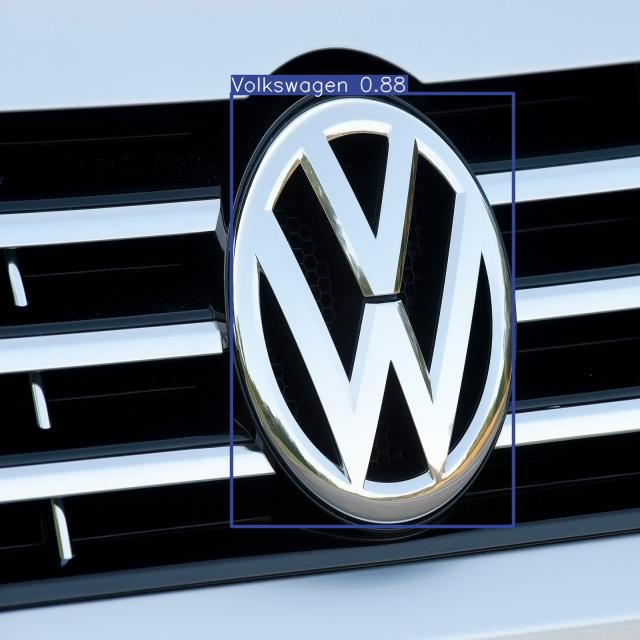

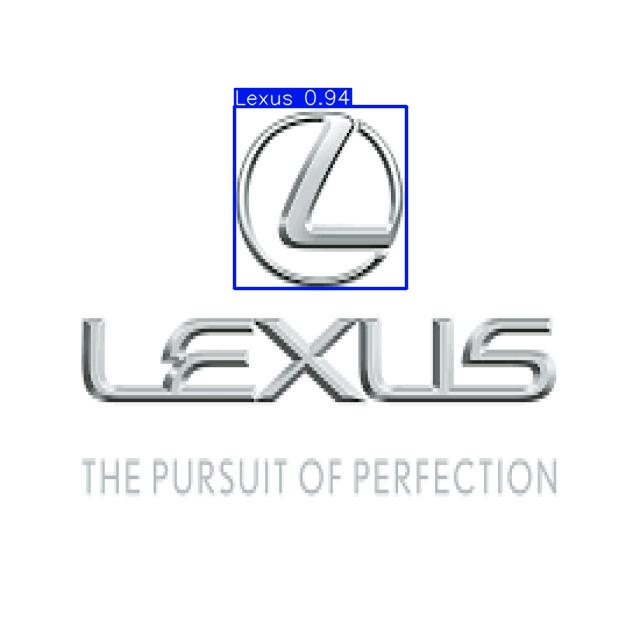

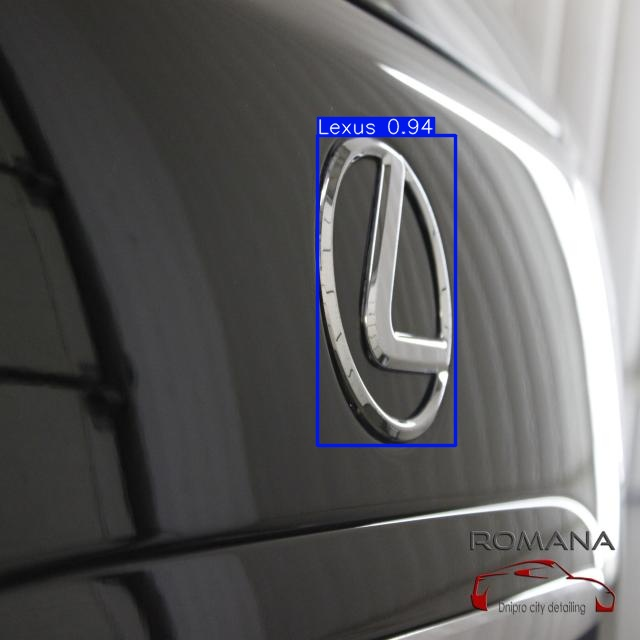

In [9]:
import glob
from IPython.display import display, Image

for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg'):
  display(Image(filename=image_path, height=600))
  print("\n")

In [10]:
!yolo task=detect mode=predict model = '/content/runs/detect/train2/weights/best.pt' show=True conf=0.5 source=vid.mp4

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

Ultralytics YOLOv8.0.227 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25850761 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (1/720) /content/vid.mp4: 384x640 (no detections), 119.8ms
video 1/1 (2/720) /content/vid.mp4: 384x640 1 Toyota, 25.2ms
video 1/1 (3/720) /content/vid.mp4: 384x640 (no detections), 25.2ms
video 1/1 (4/720) /content/vid.mp4: 384x640 (no detections), 25.1ms
video 1/1 (5/720) /content/vid.mp4: 384x640 1 Toyota, 25.1ms
video 1/1 (6/720) /content/vid.mp4: 384x640 1 Toyota, 25.1ms
video 1/1 (7/720) /content/vid.mp4: 384x640 (no detections), 25.1ms
video 1/1 (8/720) /content/vid.mp4: 384x640 (no detections), 25.1ms
video 1/1 (9/720) /content/vid.mp4: 384x640 (no detections), 25.1ms
video 1/1 (10/720) /content/vid.mp4: 384x640 (no detections), 17.0ms
video 1/1 (11/720) /content/vid.mp4: 384x640 (no detections), 17.0ms
video 1/1 (12/720) /conten